<a href="https://colab.research.google.com/github/Xreckly/Model-Lying/blob/main/ModelLying.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

READ ME:

In order to run the code, you need two audio files, one of someone lying and one of someone telling the truth in wav file format.

**--Getting file the way I did it--**

They way I inputed my two wave files was to put the two audio files into a folder inside my google drive. Then using blocks 2, 3, 4, it loads the files from my google drive into an array and test the files. The path google drive starts of as is /content. /content/drive will take you to your google drive folder. Then just locate where you found the folder and /folder_name. Then /*wav takes all the wave files from that folder.

**--Getting file yourself--**

In the 5th block, there is two variables named 'filename' and 'filename2'. For 'filename', it should be the wav file of someone lying and for 'filename2', it should be the wav file of someone telling the truth. Comment out or delete blocks 2, 3, and 4.





In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from glob import glob
import librosa
import librosa.display
import IPython.display as ipd
from itertools import cycle
import sys
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn import linear_model
from sklearn.preprocessing import PolynomialFeatures
from mlxtend.plotting import plot_decision_regions
from sklearn.model_selection import cross_val_score
from sklearn.pipeline import make_pipeline

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
audio_files = glob("/content/drive/MyDrive/Data/*.wav")

# Test audio file
ipd.Audio(audio_files[0])

#index 0 = IMPOSTER
#index 1 = INNOCENT

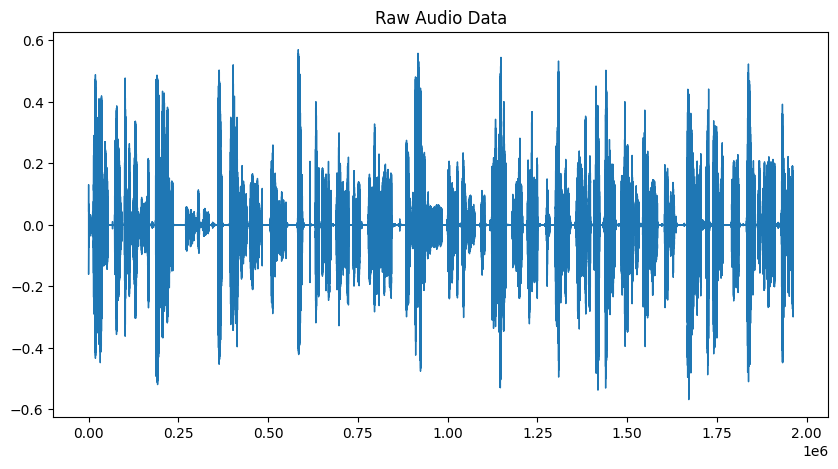

In [4]:
# Seeing raw audio data and testing if audio file opens correctly
y, sr = librosa.load(audio_files[1])
pd.Series(y).plot(figsize=(10, 5),
                  lw=1,
                  title = "Raw Audio Data"
                  )

plt.show()

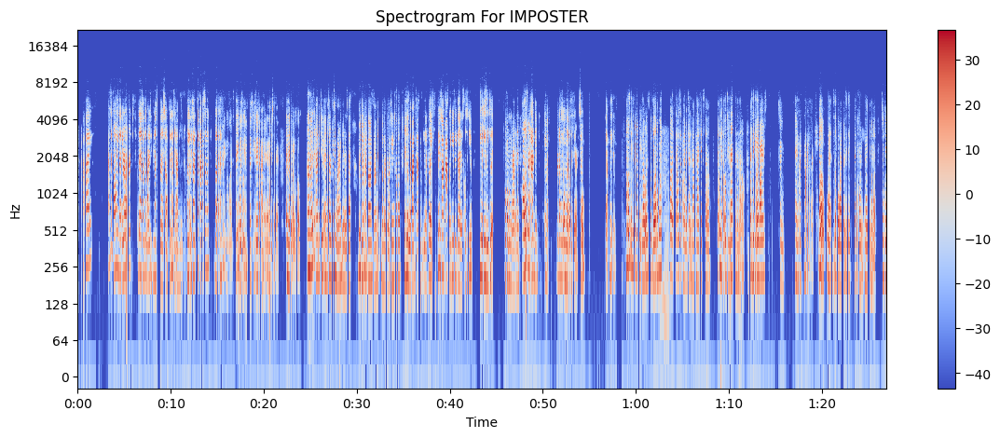

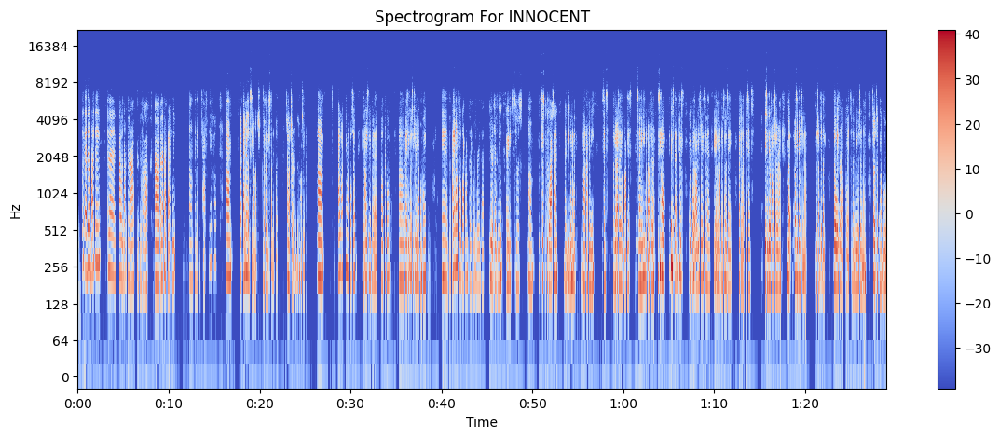

,Similar_Frequencies,Number_Of_Gaps,Avg_db,Imposter
1,47820.0,176.0,0.015703,1.0
2,64636.8,54.0,0.042026,1.0
3,68429.8,41.0,0.031645,1.0
4,66265.8,33.0,0.022563,1.0
5,45678.2,107.0,0.024163,1.0
6,63946.4,23.0,0.054067,1.0
7,57922.4,34.0,0.050084,1.0
8,65555.6,25.0,0.058177,1.0
9,59209.2,93.0,0.031802,1.0
10,54570.2,98.0,0.002452,1.0


In [37]:
filename = audio_files[0] # imposter audio file
filename2 = audio_files[1] # Audiofile for innocent
np.set_printoptions(threshold=sys.maxsize)

#--CREATING DATA FOR FILE1--#
Fs = 44100
clip, sample_rate = librosa.load(filename, sr=Fs)
n_fft = 1024  # frame length
start = 0
hop_length=512

X = librosa.stft(clip, n_fft=n_fft, hop_length=hop_length)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(14, 5))
librosa.display.specshow(Xdb, sr=Fs, x_axis='time', y_axis='log')
plt.colorbar()
plt.title("Spectrogram For IMPOSTER")
plt.show()

t_samples = np.arange(clip.shape[0]) / Fs
t_frames = np.arange(X.shape[1]) * hop_length / Fs
#f_hertz = np.arange(N / 2 + 1) * Fs / N       # Works only when N is even
f_hertz = np.fft.rfftfreq(n_fft, 1 / Fs)         # Works also when N is odd

#print('Time (seconds) :', len(t_samples))
#prints array of time frames
#print('Time of frames (seconds) : ', t_frames)
#prints array of frequency bins
#print('Frequency (Hz) : ', f_hertz)
#print('Number of frames : ', len(t_frames))
#print('Number of bins : ', len(f_hertz))

#This code is working to printout frame by frame intensity of each frequency
#on top line gives freq bins
# curLine = 'Bins,'
# for b in range(1, len(f_hertz)):
#     curLine += str(f_hertz[b]) + ','
# print(curLine)

# Data Variables
data = {}
numPoints = 1

# Variables
amount_Of_Frames = len(t_frames)
amount_Of_bins = len(f_hertz)
curLine = ''
lessThan = 5
freq = [0] * amount_Of_bins # Array to store similar frequencies
gaps = [] # Store gaps every 5 seconds
numGaps = 0 # Amount of pauses in speech per frame up to 5 seconds

for f in range(1, amount_Of_Frames):

    # Data Point for every 5 seconds
    if t_frames[f] > lessThan or f == amount_Of_Frames:
      data[str(numPoints)] = {}
      data[str(numPoints)]["Similar_Frequencies"] = sum(freq)
      data[str(numPoints)]["Number_Of_Gaps"] = numGaps

      # Clean up
      lessThan += 5
      freq[:] =[0] * amount_Of_bins
      numPoints += 1
      numGaps = 0

    #curLine = str(t_frames[f]) + ','
    gap = True
    for b in range(1, amount_Of_bins): #for each frame, we get list of bin values printed
        bin = np.abs(X[b, f])
        if bin > 0.1: # Calculation for average frequency
          gap = False
          num = freq[b]
          if num == 0:
            freq[b] += 1
          elif num == 1:
            freq[b] += 1.2
          elif num == 2:
            freq[b] += 1.5
          elif num == 3:
            freq[b] += 1.9
          else:
            freq[b] += 2.4


        #curLine += str("%.02f" % np.abs(X[b, f])) + ','
        # Remove format of the float for full details if needed
        #curLine += str(np.abs(X[b, f])) + ','
        # Print other useful info like phase of frequency bin b at frame f.
        #curLine += str("%.02f" % np.angle(X[b, f])) + ','
    #print(curLine)
    if gap == True:
      numGaps += 1

# Data for average db every 5 seocnds
count = 0
for p in range(0,len(clip),sample_rate * 5):
    if count >= len(data):
      break
    count += 1
    data[str(count)]["Avg_db"] = np.abs(clip[p:p+sample_rate]).mean()
    data[str(count)]["Imposter"] = 1
#print(data)

#--CREATING DATA FOR FILE2--#
clip2, sample_rate2 = librosa.load(filename2, sr=Fs)
X2 = librosa.stft(clip2, n_fft=n_fft, hop_length=hop_length)

t_samples2 = np.arange(clip.shape[0]) / Fs
t_frames2 = np.arange(X2.shape[1]) * hop_length / Fs
f_hertz2 = np.fft.rfftfreq(n_fft, 1 / Fs)

Xdb2 = librosa.amplitude_to_db(abs(X2))
plt.figure(figsize=(14, 5))
librosa.display.specshow(Xdb2, sr=Fs, x_axis='time', y_axis='log')
plt.title("Spectrogram For INNOCENT")
plt.colorbar()
plt.show()

# Variables
amount_Of_Frames2 = len(t_frames2)
amount_Of_bins2 = len(f_hertz2)
data2 = {}
lessThan2 = 5
freq2 = [0] * amount_Of_bins2 # Array to store similar frequencies
gaps2 = [] # Store gaps every 5 seconds
numGaps2 = 0 # Amount of pauses in speech per frame up to 5 seconds

for f in range(1, amount_Of_Frames2):

    # Data Point for every 5 seconds
    if t_frames2[f] > lessThan2 or f == amount_Of_Frames2:
      data[str(numPoints)] = {}
      data[str(numPoints)]["Similar_Frequencies"] = sum(freq2)
      data[str(numPoints)]["Number_Of_Gaps"] = numGaps2

      # Clean up
      lessThan2 += 5
      freq2[:] =[0] * amount_Of_bins2
      numPoints += 1
      numGaps2 = 0

    #curLine = str(t_frames[f]) + ','
    gap = True
    for b in range(1, amount_Of_bins2): #for each frame, we get list of bin values printed
        bin = np.abs(X2[b, f])
        if bin > 0.1: # Calculation for average frequency
          gap = False
          num = freq2[b]
          if num == 0:
            freq2[b] += 1
          elif num == 1:
            freq2[b] += 1.2
          elif num == 2:
            freq2[b] += 1.5
          elif num == 3:
            freq2[b] += 1.9
          else:
            freq2[b] += 2.4
    if gap == True:
      numGaps2 += 1

# Data for average db every 5 seocnds
for p in range(0,len(clip2),sample_rate2 * 5):
    if count >= len(data):
      break
    count += 1
    data[str(count)]["Avg_db"] = np.abs(clip2[p:p+sample_rate2]).mean()
    data[str(count)]["Imposter"] = 0

df = pd.DataFrame(data=data).T
df # Print created data set

In [33]:
#--Logistic Regression--#
X = df.drop(columns = "Imposter")
y = df["Imposter"]

# Split 30% of data for testing and leave the rest for training
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state = 21)
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.fit_transform(X_test)
logistic_regression = LogisticRegression(random_state = 0).fit(X_train_scaled, y_train)

prediction = logistic_regression.predict(X_train_scaled)
prediction_test = logistic_regression.predict(X_test_scaled)
numCorrect = 0
for c in range(len(prediction)):
  if prediction[c] == y_train[c]:
    numCorrect += 1
print("Accuracy for training data = " + str(round((numCorrect / len(prediction)), 3)))

numCorrect = 0
for r in range(len(prediction_test)):
  if prediction_test[r] == y_test[r]:
    numCorrect += 1
print("Accuracy for testing data = " + str(round((numCorrect / len(prediction_test)), 3)))

# Adding Polynomial Features
poly = PolynomialFeatures(degree=2,include_bias=False)
poly_new = poly.fit_transform(X_test_scaled)
model = make_pipeline(PolynomialFeatures(degree=2),
                      linear_model.LogisticRegression())
model.fit(X_train_scaled, y_train)
poly_predic = model.predict(X_train_scaled)
poly_predic_test = model.predict(X_test_scaled)

numCorrect = 0
for c in range(len(poly_predic)):
  if poly_predic[c] == y_train[c]:
    numCorrect += 1
print("Accuracy for training data with polynomial features = " + str(round((numCorrect / len(poly_predic)), 3)))

numCorrect = 0
for r in range(len(poly_predic_test)):
  if poly_predic_test[r] == y_test[r]:
    numCorrect += 1
print("Accuracy for testing data with polynomial features = " + str(round((numCorrect / len(poly_predic_test)), 3)))

# Adding Polyfeatures fixes underfitting as we can see the training data is more accurate than the testing data



Accuracy for training data = 0.696
Accuracy for testing data = 0.818
Accuracy for training data with polynomial features = 0.783
Accuracy for testing data with polynomial features = 0.636
